In [1]:
import numpy as np
import pandas as pd

import helpers
from helpers.cell_type_naming import weird_to_nice

In [2]:
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io

plotly.io.renderers.default = "jupyterlab+png"

In [3]:
import logging

In [4]:
handler = logging.StreamHandler()
formatter = logging.Formatter("%(asctime)s - %(name)s - %(levelname)s - %(message)s")
handler.setFormatter(formatter)
logging.getLogger().addHandler(handler)

In [5]:
logging.getLogger("helpers").setLevel("DEBUG")
logger = logging.getLogger(__name__)
logger.setLevel("DEBUG")

In [6]:
rng = np.random.default_rng(seed=0)

# set params

In [7]:
# samples to include
only_include_metastases = True
# genes to include
gene_sparsity_ceiling = 0.5  # ignored if None

# pseudobulk parameters
n_cells_per_cell_type = 5
malignant_from_one_sample = True

# load & prep data

## real TCGA bulk samples

In [8]:
# mixtures_tcga_skcm = helpers.datasets.load_tcga_skcm()

In [9]:
mixtures_tcga_skcm = helpers.datasets.load_tcga_skcm_bigquery()

2022-03-25 20:11:04,029 - helpers.datasets - DEBUG - loading TCGA SKCM bulk RNA-seq data from BigQuery
2022-03-25 20:11:04,030 - helpers.datasets - DEBUG - making query job
2022-03-25 20:11:04,614 - helpers.datasets - DEBUG - reading data from query to dataframe
Downloading: 100%|██████████| 9304064/9304064 [00:03<00:00, 2433358.86rows/s]
2022-03-25 20:11:09,525 - helpers.datasets - DEBUG - pivoting results


In [10]:
mixtures_tcga_skcm

sample_id,TCGA-3N-A9WB-06A-11R-A38C-07,TCGA-3N-A9WC-06A-11R-A38C-07,TCGA-3N-A9WD-06A-11R-A38C-07,TCGA-BF-A1PU-01A-11R-A18S-07,TCGA-BF-A1PV-01A-11R-A18U-07,TCGA-BF-A1PX-01A-12R-A18T-07,TCGA-BF-A1PZ-01A-11R-A18S-07,TCGA-BF-A1Q0-01A-21R-A18S-07,TCGA-BF-A3DJ-01A-11R-A20F-07,TCGA-BF-A3DL-01A-11R-A20F-07,...,TCGA-XV-AB01-06A-12R-A40A-07,TCGA-YD-A89C-06A-11R-A37K-07,TCGA-YD-A9TA-06A-11R-A39D-07,TCGA-YD-A9TB-06A-12R-A40A-07,TCGA-YG-AA3N-01A-11R-A38C-07,TCGA-YG-AA3O-06A-11R-A38C-07,TCGA-YG-AA3P-06A-11R-A38C-07,TCGA-Z2-A8RT-06A-11R-A37K-07,TCGA-Z2-AA3S-06A-11R-A39D-07,TCGA-Z2-AA3V-06A-11R-A39D-07
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,0.316945,0.152556,0.230553,0.158981,0.290790,0.142348,0.222355,0.277645,0.187224,0.112645,...,0.230860,0.142018,0.113168,0.272093,0.348701,0.345811,0.022653,0.232273,0.229432,0.238798
A1CF,0.000000,0.003978,0.003006,0.000000,0.000000,0.000000,0.001449,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.034970,0.000000,0.000000,0.001658,0.000000,0.001863,0.002945,0.002264
A2M,17.338106,1321.291406,124.667743,48.091445,15.678437,219.824082,24.354357,48.598480,2810.610503,49.716191,...,96.944393,151.027212,103.192914,215.388966,66.532300,290.924955,58.658701,169.931077,32.902727,251.845785
A2ML1,0.086929,0.010460,0.007904,0.127020,0.010358,20.824887,0.270623,0.100083,6.828529,0.011883,...,0.000000,0.015581,0.002299,0.011194,10.005256,0.054509,0.009320,0.019602,0.030979,0.002977
A3GALT2,0.018252,0.074675,0.056427,0.000000,0.000000,0.013936,0.013605,0.046596,0.134662,0.016966,...,0.000000,0.000000,0.164132,0.000000,0.042015,0.031130,0.000000,0.122442,0.055289,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYG11B,3.842320,4.370333,4.615579,2.489354,6.708055,2.724972,4.473528,5.983165,5.619995,0.868009,...,0.643023,4.311933,5.937579,6.963782,2.886224,6.091135,5.155709,2.996880,10.473117,0.344766
ZYX,17.572519,53.575538,41.710301,67.484080,82.964259,58.895492,44.484107,152.540057,42.358971,81.067514,...,117.528759,72.599793,57.282269,47.762130,120.167701,46.150726,26.114543,41.024579,32.292355,118.110885
ZZEF1,1.960316,2.878303,3.141083,5.157699,3.939852,3.905660,5.091938,3.959793,4.073907,3.585307,...,3.334566,2.590584,4.236276,3.736214,6.090701,8.500123,4.290847,5.898542,5.459046,3.101429


## pseudobulk samples

### load Jerby-Arnon scRNA-seq cohort

In [11]:
sc_data, sc_metadata = helpers.datasets.load_jerby_arnon(
    # n_genes=100
)

2022-03-25 20:11:15,455 - helpers.datasets - DEBUG - loading Jerby-Arnon scRNA-seq data
2022-03-25 20:11:56,170 - helpers.datasets - DEBUG - loading Jerby-Arnon metadata


In [12]:
sc_data

single_cell_id,CY106_CD45neg_CD90neg_10cells_S289,CY106_CD45neg_CD90neg_S291,CY106_CD45neg_CD90neg_S292,CY106_CD45neg_CD90neg_S294,CY106_CD45neg_CD90neg_S297,CY106_CD45neg_CD90neg_S301,CY106_CD45neg_CD90neg_S302,CY106_CD45neg_CD90neg_S308,CY106_CD45neg_CD90neg_S310,CY106_CD45neg_CD90neg_S320,...,monika_E9_S143_comb_BCD8_3,monika_F10_S145_comb_BCD8_3,monika_F1_S144_comb_BCD8_3,monika_F2_S146_comb_BCD8_3,monika_F4_S147_comb_BCD8_3,monika_F5_S148_comb_BCD8_3,monika_F6_S149_comb_BCD8_3,monika_F7_S150_comb_BCD8_3,monika_F8_S151_comb_BCD8_3,monika_F9_S152_comb_BCD8_3
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.900722,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.482332,0.000000,0.000000
A1BG-AS1,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.328836,0.000000,0.000000,0.000000,3.593354,3.595146,0.000000,0.000000
A1CF,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.005759,0.000000,0.000000,...,0.067639,2.510709,0.021480,0.000000,0.027154,0.070389,0.034216,0.057970,0.000000,0.093560
A2M,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.639695,0.000000,0.000000,0.000000,0.000000,0.000000,5.437760,0.000000
A2M-AS1,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.314986,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYG11A,0.151859,0.038436,0.000000,0.0229,0.116365,0.000000,0.066261,0.088142,0.035624,0.051024,...,1.357270,2.597650,1.004322,0.983313,1.597889,0.835924,1.085425,1.196607,0.747602,2.592158
ZYG11B,0.000000,0.000000,0.015783,0.0229,0.000000,0.001442,0.000000,0.037031,0.017209,0.066261,...,0.853597,1.770618,0.492622,0.632268,0.913799,0.299831,0.609755,0.755315,0.590722,2.141106
ZYX,0.299831,1.227125,0.422233,0.0000,1.614945,0.000000,0.993493,2.870661,0.000000,0.000000,...,0.000000,2.849599,4.183645,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [13]:
sc_metadata

,single_cell_id,sample_id,cell_type,treatment.group,Cohort,no.of.genes,no.of.reads
single_cell_id,,,,,,,
CY106_CD45neg_CD90neg_10cells_S289,CY106_CD45neg_CD90neg_10cells_S289,Mel106,NaN,post.treatment,New,2518,1912305
CY106_CD45neg_CD90neg_S291,CY106_CD45neg_CD90neg_S291,Mel106,Malignant,post.treatment,New,3071,1945194
CY106_CD45neg_CD90neg_S292,CY106_CD45neg_CD90neg_S292,Mel106,Malignant,post.treatment,New,4848,3268805
CY106_CD45neg_CD90neg_S294,CY106_CD45neg_CD90neg_S294,Mel106,Malignant,post.treatment,New,2953,2155551
CY106_CD45neg_CD90neg_S297,CY106_CD45neg_CD90neg_S297,Mel106,Malignant,post.treatment,New,3680,3651531
...,...,...,...,...,...,...,...
monika_F5_S148_comb_BCD8_3,monika_F5_S148_comb_BCD8_3,Mel75,T CD8,post.treatment,Tirosh,6154,1557222
monika_F6_S149_comb_BCD8_3,monika_F6_S149_comb_BCD8_3,Mel75,T CD8,post.treatment,Tirosh,6312,1638252
monika_F7_S150_comb_BCD8_3,monika_F7_S150_comb_BCD8_3,Mel75,T CD8,post.treatment,Tirosh,5767,1132051


### load fractions produced by derek

In [14]:
csx_fraction_output_tcga_skcm = helpers.datasets.load_tcga_skcm_fractions_from_csx()

2022-03-25 20:11:56,341 - helpers.datasets - DEBUG - loading TCGA SKCM fractions estimated by CIBERSORTx


In [15]:
csx_fraction_output_tcga_skcm

cell_type,B,CAF,Endothelial,Macrophage,Malignant,NK,T,T CD4,T CD8
sample_id,,,,,,,,,
TCGA-3N-A9WB-06A-11R-A38C-07,0.000000,0.018483,0.004211,0.000000,0.971059,0.000000,0.006247,0.000000,0.000000
TCGA-3N-A9WC-06A-11R-A38C-07,0.035060,0.056463,0.004178,0.103408,0.669623,0.000000,0.000000,0.082836,0.048432
TCGA-3N-A9WD-06A-11R-A38C-07,0.044227,0.105762,0.070834,0.036322,0.703525,0.000000,0.000000,0.039330,0.000000
TCGA-BF-A1PU-01A-11R-A18S-07,0.020758,0.048434,0.015335,0.000000,0.912796,0.002677,0.000000,0.000000,0.000000
TCGA-BF-A1PV-01A-11R-A18U-07,0.003591,0.042464,0.000000,0.000000,0.944365,0.000000,0.000000,0.009580,0.000000
...,...,...,...,...,...,...,...,...,...
TCGA-YG-AA3O-06A-11R-A38C-07,0.007658,0.060723,0.000000,0.026970,0.896399,0.000000,0.008250,0.000000,0.000000
TCGA-YG-AA3P-06A-11R-A38C-07,0.000000,0.000000,0.002483,0.008485,0.969895,0.000000,0.019137,0.000000,0.000000
TCGA-Z2-A8RT-06A-11R-A37K-07,0.029734,0.026755,0.002953,0.044928,0.878121,0.000000,0.000000,0.017508,0.000000


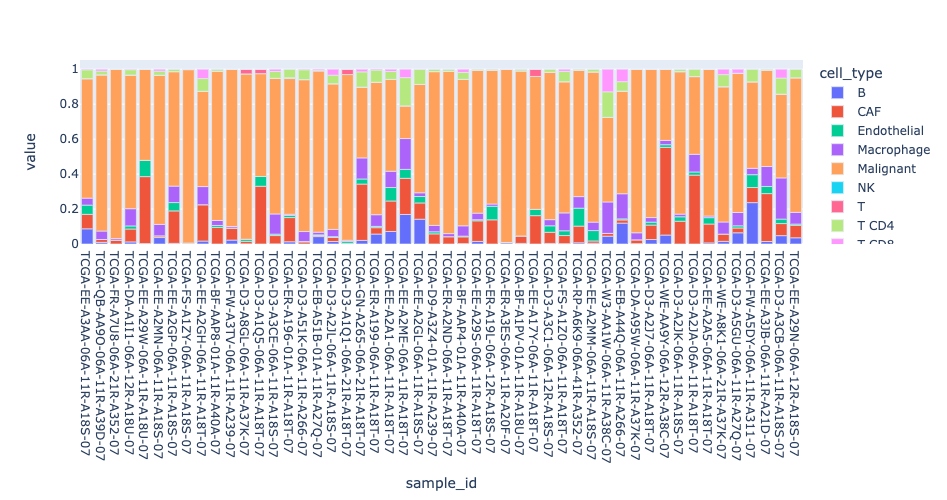

In [16]:
px.bar(csx_fraction_output_tcga_skcm.sample(50))

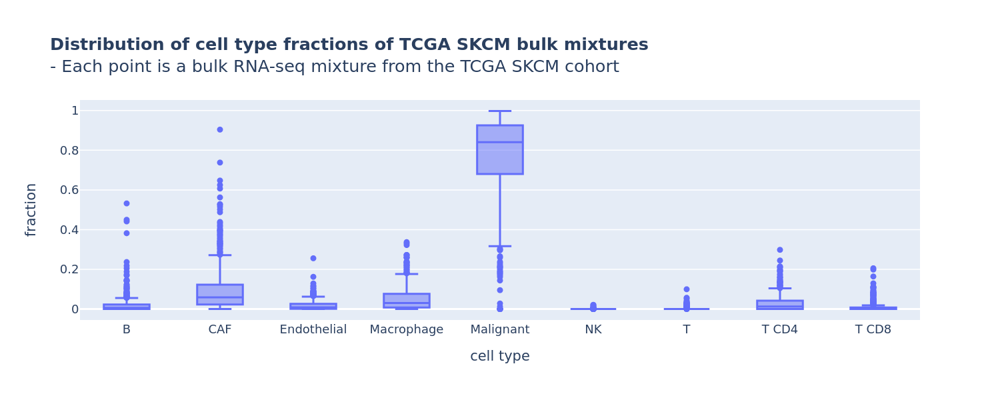

In [17]:
title = (
    "<b>Distribution of cell type fractions of TCGA SKCM bulk mixtures</b>"
    "<br>- Each point is a bulk RNA-seq mixture from the TCGA SKCM cohort"
)

fig = px.box(csx_fraction_output_tcga_skcm, title=title)

# fig.update_layout(font_size=12)
fig.update_xaxes(title="cell type")
fig.update_yaxes(title="fraction")

fig.show(width=1000, height=400, scale=1.5, renderer="png")

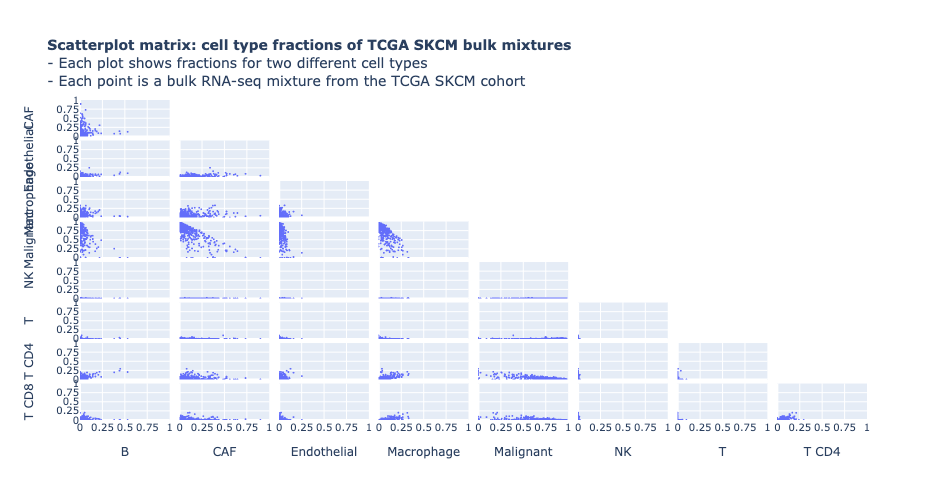

In [18]:
title = (
    "<b>Scatterplot matrix: cell type fractions of TCGA SKCM bulk mixtures</b>"
    "<br>- Each plot shows fractions for two different cell types"
    "<br>- Each point is a bulk RNA-seq mixture from the TCGA SKCM cohort"
)

fig = px.scatter_matrix(
    csx_fraction_output_tcga_skcm,
    title=title,
)
fig.update_layout(font_size=10)
fig.update_layout({f"xaxis{i + 1}": dict(range=[0, 1], dtick=0.25) for i in range(9)})
fig.update_layout({f"yaxis{i + 1}": dict(range=[0, 1], dtick=0.25) for i in range(9)})
fig.update_traces(diagonal_visible=False)
fig.update_traces(marker=dict(size=2))
fig.update_traces(showupperhalf=False)

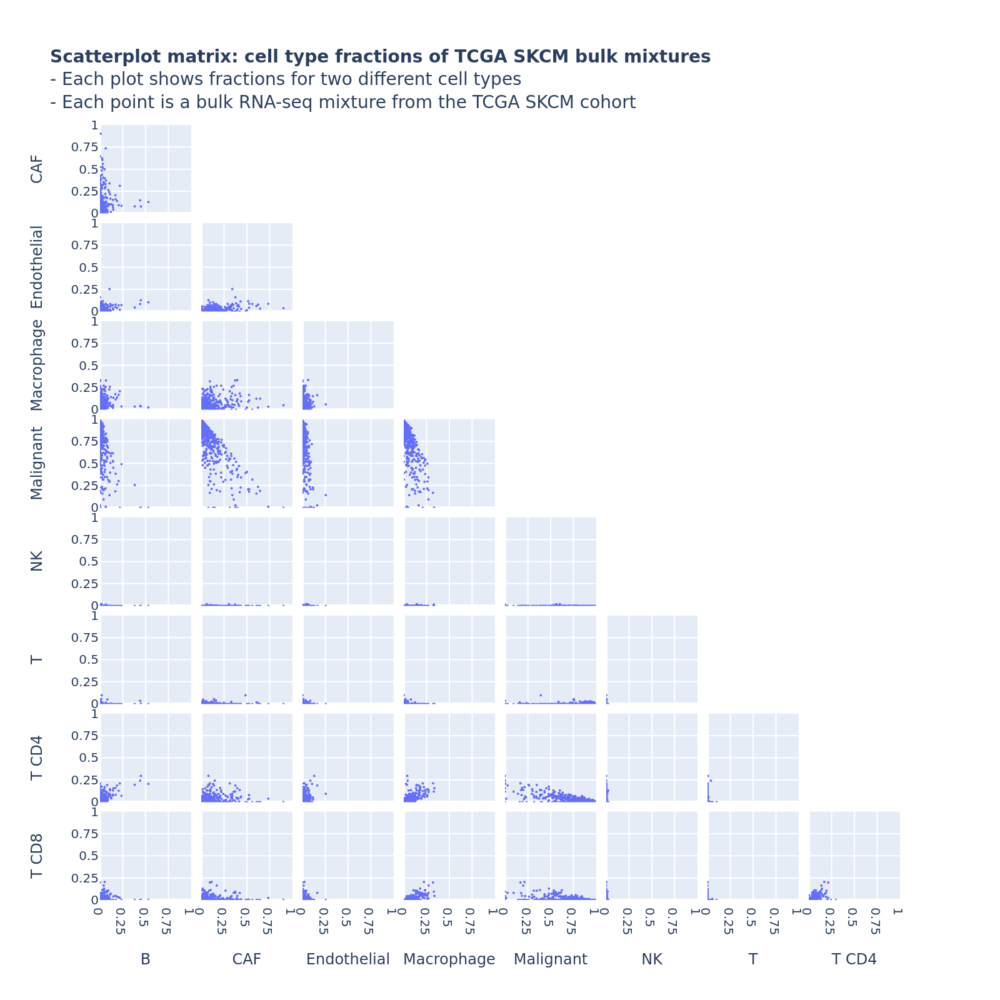

In [19]:
# for google presentations, which accepts 1600 x 1600

fig.show(width=800, height=800, scale=2, renderer="png")

### compute pseudobulks from Jerby-Arnon cohort, fractions

In [20]:
in_silico_fractions = csx_fraction_output_tcga_skcm.rename(
    index=lambda sample: f"in_silico_like_{sample}"
)

In [21]:
in_silico_fractions

cell_type,B,CAF,Endothelial,Macrophage,Malignant,NK,T,T CD4,T CD8
sample_id,,,,,,,,,
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07,0.000000,0.018483,0.004211,0.000000,0.971059,0.000000,0.006247,0.000000,0.000000
in_silico_like_TCGA-3N-A9WC-06A-11R-A38C-07,0.035060,0.056463,0.004178,0.103408,0.669623,0.000000,0.000000,0.082836,0.048432
in_silico_like_TCGA-3N-A9WD-06A-11R-A38C-07,0.044227,0.105762,0.070834,0.036322,0.703525,0.000000,0.000000,0.039330,0.000000
in_silico_like_TCGA-BF-A1PU-01A-11R-A18S-07,0.020758,0.048434,0.015335,0.000000,0.912796,0.002677,0.000000,0.000000,0.000000
in_silico_like_TCGA-BF-A1PV-01A-11R-A18U-07,0.003591,0.042464,0.000000,0.000000,0.944365,0.000000,0.000000,0.009580,0.000000
...,...,...,...,...,...,...,...,...,...
in_silico_like_TCGA-YG-AA3O-06A-11R-A38C-07,0.007658,0.060723,0.000000,0.026970,0.896399,0.000000,0.008250,0.000000,0.000000
in_silico_like_TCGA-YG-AA3P-06A-11R-A38C-07,0.000000,0.000000,0.002483,0.008485,0.969895,0.000000,0.019137,0.000000,0.000000
in_silico_like_TCGA-Z2-A8RT-06A-11R-A37K-07,0.029734,0.026755,0.002953,0.044928,0.878121,0.000000,0.000000,0.017508,0.000000


In [22]:
rng.bit_generator.state["state"] = {
    "state": 18792671013009471063546316241193924174,
    "inc": 87136372517582989555478159403783844777,
}

mixtures_in_silico, cell_type_geps = helpers.creating_mixtures.make_mixtures(
    sc_data,
    sc_metadata,
    in_silico_fractions,
    n_cells_per_gep=n_cells_per_cell_type,
    normalization_factor=1_000_000,
    malignant_from_one_sample=malignant_from_one_sample,
    rng=rng,
)

2022-03-25 20:12:06,186 - helpers.creating_mixtures - DEBUG - using np.random.Generator with BitGenerator state {'state': 35399562948360463058890781895381311971, 'inc': 87136372517582989555478159403783844777}
2022-03-25 20:12:06,221 - helpers.creating_mixtures - DEBUG - randomly chose Mel79 for malignant cells
2022-03-25 20:12:06,257 - helpers.creating_mixtures - DEBUG - randomly chose Mel112 for malignant cells
2022-03-25 20:12:06,290 - helpers.creating_mixtures - DEBUG - randomly chose Mel81 for malignant cells
2022-03-25 20:12:06,323 - helpers.creating_mixtures - DEBUG - randomly chose Mel128 for malignant cells
2022-03-25 20:12:06,355 - helpers.creating_mixtures - DEBUG - randomly chose Mel82 for malignant cells
2022-03-25 20:12:06,390 - helpers.creating_mixtures - DEBUG - randomly chose Mel89 for malignant cells
2022-03-25 20:12:06,424 - helpers.creating_mixtures - DEBUG - randomly chose Mel53 for malignant cells
2022-03-25 20:12:06,457 - helpers.creating_mixtures - DEBUG - random

In [23]:
mixtures_in_silico

,in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07,in_silico_like_TCGA-3N-A9WC-06A-11R-A38C-07,in_silico_like_TCGA-3N-A9WD-06A-11R-A38C-07,in_silico_like_TCGA-BF-A1PU-01A-11R-A18S-07,in_silico_like_TCGA-BF-A1PV-01A-11R-A18U-07,in_silico_like_TCGA-BF-A1PX-01A-12R-A18T-07,in_silico_like_TCGA-BF-A1PZ-01A-11R-A18S-07,in_silico_like_TCGA-BF-A1Q0-01A-21R-A18S-07,in_silico_like_TCGA-BF-A3DJ-01A-11R-A20F-07,in_silico_like_TCGA-BF-A3DL-01A-11R-A20F-07,...,in_silico_like_TCGA-XV-AB01-06A-12R-A40A-07,in_silico_like_TCGA-YD-A89C-06A-11R-A37K-07,in_silico_like_TCGA-YD-A9TA-06A-11R-A39D-07,in_silico_like_TCGA-YD-A9TB-06A-12R-A40A-07,in_silico_like_TCGA-YG-AA3N-01A-11R-A38C-07,in_silico_like_TCGA-YG-AA3O-06A-11R-A38C-07,in_silico_like_TCGA-YG-AA3P-06A-11R-A38C-07,in_silico_like_TCGA-Z2-A8RT-06A-11R-A37K-07,in_silico_like_TCGA-Z2-AA3S-06A-11R-A39D-07,in_silico_like_TCGA-Z2-AA3V-06A-11R-A39D-07
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,57.518502,80.103327,23.405393,67.962657,113.942787,20.565631,5.915556,36.470932,79.222502,43.658954,...,32.665090,1.157198,23.808308,26.659070,78.436235,132.774184,21.160793,49.197093,83.361818,124.165168
A1BG-AS1,40.765672,59.027257,21.094747,0.015008,0.106724,14.334200,41.484251,3.543980,54.100537,33.874997,...,0.406896,0.069523,18.203728,1.618747,12.939561,0.850573,32.411702,0.123820,0.220217,25.700122
A1CF,7.363467,2.512825,0.712508,0.045822,3.147617,1.609660,1.097012,1.634286,0.183278,3.351370,...,0.299595,3.585102,0.132446,0.465668,0.190847,6.105131,2.507392,0.665611,0.143745,3.072958
A2M,701.363073,466.249775,391.215539,67.851506,234.233317,171.717512,2.258586,349.563021,287.161398,254.350833,...,407.046862,81.366122,401.579129,504.251485,384.214479,38.370857,201.467860,332.995150,437.647733,122.164290
A2M-AS1,0.000000,0.677161,25.341645,4.054851,241.712907,3.303023,0.383613,12.749728,3.268397,26.677574,...,2.383548,0.000317,2.377085,96.357964,1.225949,27.798336,0.033398,0.509401,2.373850,12.465840
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYG11A,69.771115,42.945862,48.927897,41.400544,2.197845,42.763763,24.444089,51.245195,38.482996,39.631975,...,13.966395,31.137023,38.306207,32.476860,20.912787,66.975116,13.193836,14.902497,7.109921,99.874266
ZYG11B,25.366064,39.438176,34.648643,26.699516,43.306978,74.234390,42.013703,77.132398,34.282543,35.831841,...,27.572949,61.105787,69.651514,32.082017,14.262494,30.885197,28.077755,7.221580,34.384748,76.244254
ZYX,69.127268,54.302713,180.010099,37.361569,177.357263,118.806917,135.620064,65.829767,83.275684,68.558830,...,18.574341,4.993695,205.047808,70.097937,30.550952,119.544723,43.589209,14.077193,8.361661,129.612387


In [24]:
sample_name = "in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07"
cell_type_geps[sample_name]

,B,CAF,Endothelial,Macrophage,Malignant,NK,T,T CD4,T CD8
gene_symbol,,,,,,,,,
A1BG,17.311467,0.000000,42.923600,38.731062,53.990604,0.000000,0.000000,17.355319,0.000000
A1BG-AS1,31.903162,0.000000,0.000000,6.466546,44.316876,0.000000,0.000000,0.000000,0.000000
A1CF,0.359362,3.974756,0.715698,0.853535,7.129208,16.474884,5.156327,0.632116,5.215886
A2M,0.000000,275.289443,650.702929,153.248027,675.067225,89.642864,82.865144,26.975358,85.582394
A2M-AS1,0.000000,0.000000,0.000000,6.787902,0.000000,129.525404,0.000000,0.000000,46.533494
...,...,...,...,...,...,...,...,...,...
ZYG11A,67.148761,43.168425,85.167921,37.014608,76.045568,111.082541,95.626028,60.978703,162.688618
ZYG11B,82.365941,28.849841,79.402600,42.016593,26.537023,47.594353,71.799343,43.558113,103.923845
ZYX,0.000000,197.506523,119.114266,240.848622,62.595191,66.375290,93.899538,70.665047,67.569780


## QA

### exclude genes not in both TCGA bulks, pseudobulks

looks like not really... # rows in expression data:
- TCGA SKCM: 20,531
- in silico mixtures (jerby-arnon): 23,686
- overlap: 18,762

In [25]:
mixtures_tcga_skcm.shape

(19712, 472)

In [26]:
mixtures_in_silico.shape

(23686, 473)

In [27]:
len(mixtures_tcga_skcm.index.intersection(mixtures_in_silico.index))

18652

random genes in jerby-arnon, not in TCGA SKCM:

In [28]:
# todo

random genes in TCGA SKCM, not in jerby-arnon:

In [29]:
# todo

#### percent of gene symbols in one but not both cohorts

In [30]:
label_real = "real (tcga skcm)"
label_pseudo = "pseudo (jerby-arnon derived)"

In [31]:
pd.concat(
    {
        label_real: mixtures_tcga_skcm.mean(axis="columns"),
        label_pseudo: mixtures_in_silico.mean(axis="columns"),
    },
    axis=1,
).isnull().any(axis=1).mean()

0.24626202214499313

In [32]:
genes_in_common = mixtures_tcga_skcm.index.intersection(mixtures_in_silico.index)

In [33]:
genes_in_common

Index(['A1BG', 'A1CF', 'A2M', 'A2ML1', 'A4GALT', 'A4GNT', 'AAAS', 'AACS',
       'AADAC', 'AADACL2',
       ...
       'ZWILCH', 'ZWINT', 'ZXDA', 'ZXDB', 'ZXDC', 'ZYG11A', 'ZYG11B', 'ZYX',
       'ZZEF1', 'ZZZ3'],
      dtype='object', name='gene_symbol', length=18652)

In [34]:
len(mixtures_tcga_skcm), len(mixtures_in_silico)

(19712, 23686)

#### bookmark

In [35]:
mixtures_tcga_skcm = mixtures_tcga_skcm.loc[genes_in_common]
mixtures_in_silico = mixtures_in_silico.loc[genes_in_common]

In [36]:
len(mixtures_tcga_skcm), len(mixtures_in_silico)

(18652, 18652)

### eliminate genes with sparse expression in TCGA SKCM

In [37]:
gene_sparsity = (mixtures_tcga_skcm == 0).mean(axis=1)

In [38]:
gene_sparsity

gene_symbol
A1BG      0.000000
A1CF      0.487288
A2M       0.000000
A2ML1     0.023305
A4GALT    0.000000
            ...   
ZYG11A    0.125000
ZYG11B    0.000000
ZYX       0.000000
ZZEF1     0.000000
ZZZ3      0.000000
Length: 18652, dtype: float64

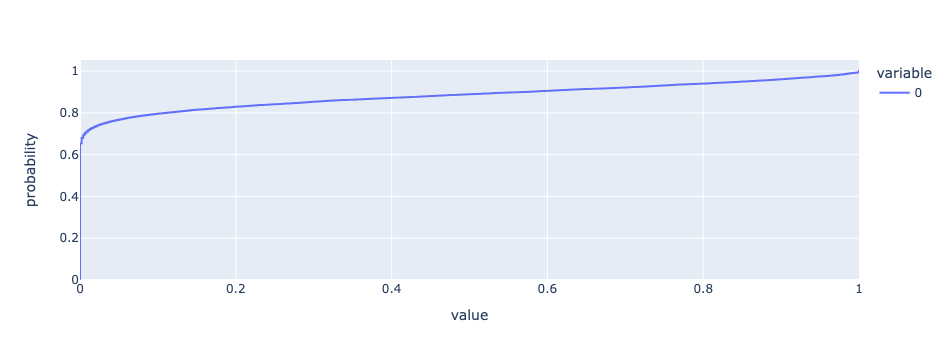

In [39]:
px.ecdf(gene_sparsity, hover_name=gene_sparsity.index).show(height=200)

#### bookmark

In [40]:
if gene_sparsity_ceiling:
    logger.debug("removing genes whose expression in TCGA SKCM is above the ceiling")
    ok_genes = gene_sparsity <= gene_sparsity_ceiling
    logger.debug(
        f"shapes before: {mixtures_tcga_skcm.shape}, {mixtures_in_silico.shape}"
    )
    mixtures_tcga_skcm = mixtures_tcga_skcm.loc[ok_genes]
    mixtures_in_silico = mixtures_in_silico.loc[ok_genes]
    logger.debug(
        f"shapes after: {mixtures_tcga_skcm.shape}, {mixtures_in_silico.shape}"
    )

2022-03-25 20:12:26,487 - __main__ - DEBUG - removing genes whose expression in TCGA SKCM is above the ceiling
2022-03-25 20:12:26,488 - __main__ - DEBUG - shapes before: (18652, 472), (18652, 473)
2022-03-25 20:12:26,540 - __main__ - DEBUG - shapes after: (16578, 472), (16578, 473)


### limit samples to metastases (not primaries)

In [41]:
query = """
select sample_barcode, sample_gdc_id, case_barcode, case_gdc_id, sample_type, sample_type_name, program_name, project_short_name
from `isb-cgc-bq.TCGA.biospecimen_gdc_current`
where project_short_name = "TCGA-SKCM"
"""

local_path = "/tmp/tcga_skcm_metadata.feather"

try:
    logger.debug("attempting to read metadata backup")
    pd.read_feather(local_path)
except OSError:
    logger.debug("read failed. fetching data from BigQuery.")
    _ = pd.read_gbq(query, project_id="keen-dispatch-316219")
    logger.debug("saving BigQuery results to local feather file.")
    _.to_feather(local_path)

mixtures_tcga_skcm_metadata = pd.read_feather(local_path)

2022-03-25 20:12:26,549 - __main__ - DEBUG - attempting to read metadata backup
2022-03-25 20:12:26,566 - __main__ - DEBUG - read failed. fetching data from BigQuery.
2022-03-25 20:12:30,883 - __main__ - DEBUG - saving BigQuery results to local feather file.


In [42]:
mixtures_tcga_skcm_metadata

,sample_barcode,sample_gdc_id,case_barcode,case_gdc_id,sample_type,sample_type_name,program_name,project_short_name
0,TCGA-GN-A4U4-06A,12dc3f5a-49a4-4f56-935d-eb09a6789523,TCGA-GN-A4U4,6dc9c5b0-77e6-4c53-a75c-8f01731c54e8,06,Metastatic,TCGA,TCGA-SKCM
1,TCGA-XV-AAZW-01A,bc0f35e6-f464-4c3e-b506-e13c4598db41,TCGA-XV-AAZW,7436a28f-01a3-4148-b38e-63c57b5d86c4,01,Primary solid Tumor,TCGA,TCGA-SKCM
2,TCGA-D3-A2JG-06A,a676720b-27eb-463a-acd5-44801d2cb9ac,TCGA-D3-A2JG,47a16bf2-229b-4e9a-8b5e-3dcc61fa9106,06,Metastatic,TCGA,TCGA-SKCM
3,TCGA-EE-A29H-06A,92ae970d-75b4-4d9f-b84f-a2070f0cbe90,TCGA-EE-A29H,c8ba1856-d055-4dc6-a184-72763c76aae4,06,Metastatic,TCGA,TCGA-SKCM
4,TCGA-D3-A2JP-10A,071d73d9-5c08-4be9-8c14-df3d6ec9bf56,TCGA-D3-A2JP,e9a42a85-9513-41b2-a71d-6d62f70b00e4,10,Blood Derived Normal,TCGA,TCGA-SKCM
...,...,...,...,...,...,...,...,...
943,TCGA-GN-A269-01A,d04c5680-bad7-4967-b292-416a028c7cbf,TCGA-GN-A269,f9d113e3-9127-491c-9227-33770bf2b23f,01,Primary solid Tumor,TCGA,TCGA-SKCM
944,TCGA-D3-A3C8-10A,5dbb9cc8-5c79-4c61-b414-39c9030ab221,TCGA-D3-A3C8,16182443-12a1-4b0f-a6ab-33c2942e2991,10,Blood Derived Normal,TCGA,TCGA-SKCM
945,TCGA-EB-A430-10A,e42c6af8-7a5c-4081-84c4-265af021a5f9,TCGA-EB-A430,d0c3a83d-a1bf-4e9a-a610-2fb4370f2891,10,Blood Derived Normal,TCGA,TCGA-SKCM
946,TCGA-EE-A3J5-10A,19787591-5edb-4224-a860-85aacab17b5c,TCGA-EE-A3J5,d6283ab0-9019-4ad2-93aa-2e6b39cd9641,10,Blood Derived Normal,TCGA,TCGA-SKCM


In [43]:
mixtures_tcga_skcm_metadata["sample_type_name"].value_counts()

Blood Derived Normal     470
Metastatic               369
Primary solid Tumor      104
Solid Tissue Normal        3
Additional Metastatic      2
Name: sample_type_name, dtype: int64

In [44]:
mets = mixtures_tcga_skcm_metadata["sample_type_name"] == "Metastatic"
metastatic_sample_barcodes = mixtures_tcga_skcm_metadata.loc[mets]["sample_barcode"]

In [45]:
def is_a_metastasic_sample(sample_id):
    # checks if sample_id contains the barcode string of any metastatic sample from TCGA
    return any(metastatic_sample_barcodes.apply(sample_id.__contains__))

In [46]:
mixtures_tcga_skcm[filter(is_a_metastasic_sample, mixtures_tcga_skcm.columns)]

sample_id,TCGA-3N-A9WB-06A-11R-A38C-07,TCGA-3N-A9WC-06A-11R-A38C-07,TCGA-3N-A9WD-06A-11R-A38C-07,TCGA-BF-AAP0-06A-11R-A39D-07,TCGA-D3-A1Q1-06A-21R-A18T-07,TCGA-D3-A1Q3-06A-11R-A18T-07,TCGA-D3-A1Q4-06A-11R-A18T-07,TCGA-D3-A1Q5-06A-11R-A18T-07,TCGA-D3-A1Q6-06A-11R-A18T-07,TCGA-D3-A1Q7-06A-11R-A18T-07,...,TCGA-WE-AAA4-06A-12R-A38C-07,TCGA-XV-AB01-06A-12R-A40A-07,TCGA-YD-A89C-06A-11R-A37K-07,TCGA-YD-A9TA-06A-11R-A39D-07,TCGA-YD-A9TB-06A-12R-A40A-07,TCGA-YG-AA3O-06A-11R-A38C-07,TCGA-YG-AA3P-06A-11R-A38C-07,TCGA-Z2-A8RT-06A-11R-A37K-07,TCGA-Z2-AA3S-06A-11R-A39D-07,TCGA-Z2-AA3V-06A-11R-A39D-07
gene_symbol,,,,,,,,,,,,,,,,,,,,,
A1BG,0.316945,0.152556,0.230553,0.381722,0.354659,0.233250,0.197393,0.574894,0.129815,0.159794,...,0.146837,0.230860,0.142018,0.113168,0.272093,0.345811,0.022653,0.232273,0.229432,0.238798
A1CF,0.000000,0.003978,0.003006,0.000000,0.004529,0.000000,0.003229,0.002789,0.004166,0.000000,...,0.000000,0.000000,0.000000,0.034970,0.000000,0.001658,0.000000,0.001863,0.002945,0.002264
A2M,17.338106,1321.291406,124.667743,173.205212,159.768608,71.787418,179.711364,324.196194,12.541680,793.751062,...,617.646584,96.944393,151.027212,103.192914,215.388966,290.924955,58.658701,169.931077,32.902727,251.845785
A2ML1,0.086929,0.010460,0.007904,0.029913,0.021837,0.019341,0.050954,0.014668,0.013694,0.017531,...,0.012991,0.000000,0.015581,0.002299,0.011194,0.054509,0.009320,0.019602,0.030979,0.002977
A4GALT,0.577348,1.901372,3.118662,3.965033,0.985225,1.233079,4.636223,8.780859,2.276762,3.866851,...,3.011008,2.152583,0.277084,2.025383,2.046308,0.762885,0.393155,0.948508,0.552535,3.102762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZYG11A,0.075578,0.024412,0.202909,0.027148,0.009266,0.002315,0.009909,0.051345,0.034089,0.042427,...,0.024255,0.000000,0.008080,0.017885,0.000000,0.013569,0.000000,0.022873,0.000000,0.000000
ZYG11B,3.842320,4.370333,4.615579,2.285002,4.046165,7.269480,4.938225,8.342821,6.997361,5.635933,...,1.108697,0.643023,4.311933,5.937579,6.963782,6.091135,5.155709,2.996880,10.473117,0.344766
ZYX,17.572519,53.575538,41.710301,87.849058,95.287660,87.520092,58.030220,60.203537,103.563303,70.635643,...,98.330748,117.528759,72.599793,57.282269,47.762130,46.150726,26.114543,41.024579,32.292355,118.110885


#### bookmark

In [47]:
if only_include_metastases:
    mixtures_tcga_skcm = mixtures_tcga_skcm[
        filter(is_a_metastasic_sample, mixtures_tcga_skcm.columns)
    ]
    mixtures_in_silico = mixtures_in_silico[
        filter(is_a_metastasic_sample, mixtures_in_silico.columns)
    ]

In [48]:
mixtures_tcga_skcm.shape, mixtures_in_silico.shape

((16578, 367), (16578, 368))

## finishing touches

### normalize expression to TPM

In [49]:
mixtures_tcga_skcm = helpers.generating_pseudobulks.normalize_expression(
    mixtures_tcga_skcm, 1_000_000
)
mixtures_in_silico = helpers.generating_pseudobulks.normalize_expression(
    mixtures_in_silico, 1_000_000
)

# output 1: compare distributions of real vs pseudo mixtures

## comparison: mean(gene expression)

### prep (compute mean expression per gene, real and pseudo)

In [50]:
pd.concat(
    {
        label_real: mixtures_tcga_skcm.mean(axis=1),
        label_pseudo: mixtures_in_silico.mean(axis=1),
    },
    axis=1,
)

,real (tcga skcm),pseudo (jerby-arnon derived)
gene_symbol,,
A1BG,0.982079,41.520093
A1CF,0.021111,1.947431
A2M,1389.333530,218.056348
A2ML1,1.566865,6.588622
A4GALT,11.900696,9.623724
...,...,...
ZYG11A,0.335573,45.247497
ZYG11B,22.991754,56.584999
ZYX,319.994008,113.171566


### correlations

#### mean(gene expression)

In [51]:
pd.concat(
    {
        label_real: mixtures_tcga_skcm.mean(axis=1),
        label_pseudo: mixtures_in_silico.mean(axis=1),
    },
    axis=1,
).corr()

,real (tcga skcm),pseudo (jerby-arnon derived)
real (tcga skcm),1.000000,0.541466
pseudo (jerby-arnon derived),0.541466,1.000000


#### mean(log(gene expression + 1))

In [52]:
pd.concat(
    {
        label_real: np.log(mixtures_tcga_skcm + 1).mean(axis=1),
        label_pseudo: np.log(mixtures_in_silico + 1).mean(axis=1),
    },
    axis=1,
).corr()

,real (tcga skcm),pseudo (jerby-arnon derived)
real (tcga skcm),1.000000,0.822064
pseudo (jerby-arnon derived),0.822064,1.000000


### hist plots

#### log scale

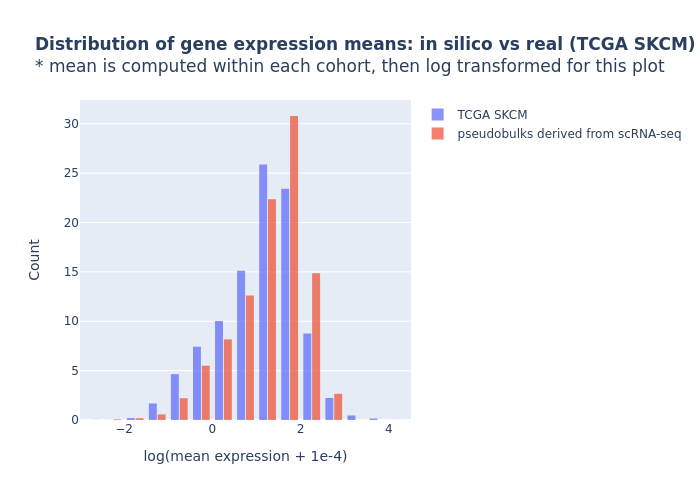

In [53]:
title = (
    "<b>Distribution of gene expression means: in silico vs real (TCGA SKCM)</b>"
    "<br>* mean is computed within each cohort, then log transformed for this plot"
)

fig = go.Figure()
fig.add_trace(
    go.Histogram(
        x=np.log10(mixtures_tcga_skcm.mean(axis=1) + 1e-4),
        histnorm="percent",
        name="TCGA SKCM",  # name used in legend and hover labels
        xbins=dict(start=-4.0, end=10.0, size=0.5),  # bins used for histogram
        opacity=0.75,
    )
)
fig.add_trace(
    go.Histogram(
        x=np.log10(mixtures_in_silico.mean(axis=1) + 1e-4),
        histnorm="percent",
        name="pseudobulks derived from scRNA-seq",
        xbins=dict(start=-3.0, end=10, size=0.5),
        # marker_color='#330C73',
        opacity=0.75,
    )
)
fig.update_layout(
    title_text=title,  # title of plot
    xaxis_title_text="log(mean expression + 1e-4)",  # xaxis label
    yaxis_title_text="Count",  # yaxis label
    bargap=0.2,  # gap between bars of adjacent location coordinates
    bargroupgap=0.1,  # gap between bars of the same location coordinates
)
# fig.update_xaxes(type="log")
fig.show()

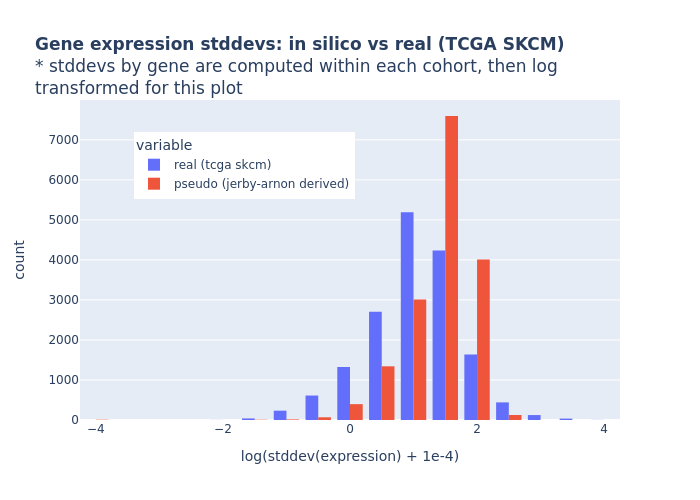

In [54]:
df = pd.concat(
    {
        label_real: np.log10(mixtures_tcga_skcm.std(axis=1) + 1e-4),
        # label_real: mixtures_tcga_skcm.mean(axis=1),
        label_pseudo: np.log10(mixtures_in_silico.std(axis=1) + 1e-4),
        # label_pseudo: mixtures_in_silico.mean(axis=1),
    },
    axis=1,
)
title = (
    "<b>Gene expression stddevs: in silico vs real (TCGA SKCM)</b>"
    "<br>* stddevs by gene are computed within each cohort, then log <br>transformed for this plot"
)

fig = px.histogram(
    df,
    barmode="group",
    # log_x=True,
    nbins=20,
    title=title,
)
fig.update_layout(
    xaxis_title="log(stddev(expression) + 1e-4)",  # xaxis label
)
fig.update_layout(
    legend=dict(
        yanchor="top",
        y=0.9,
        xanchor="left",
        x=0.1,
    )
)

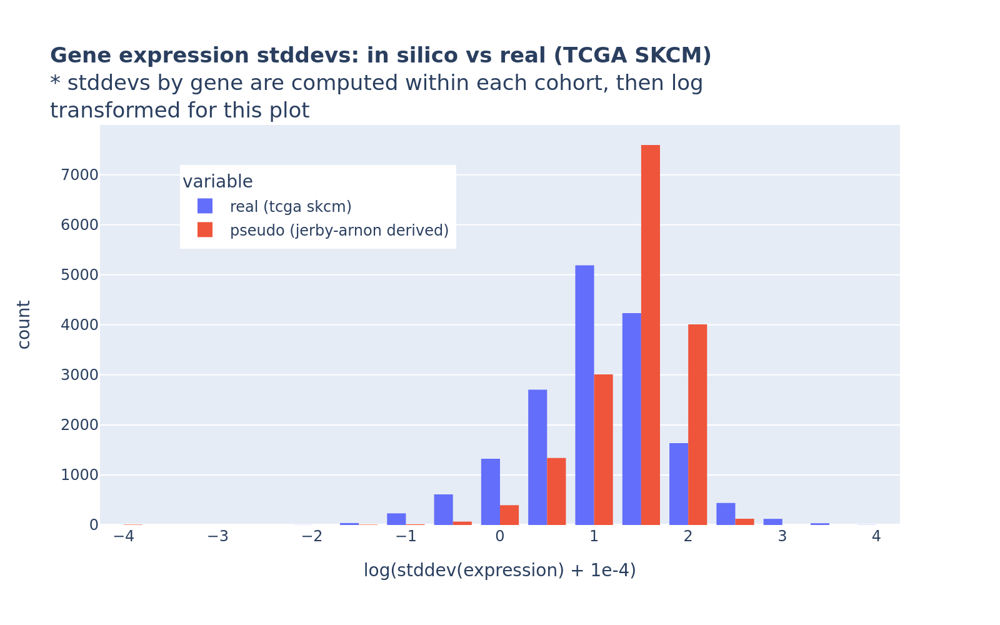

In [55]:
fig.show(width=800, height=500, scale=2, renderer="png")

### scatter plot

#### log scale

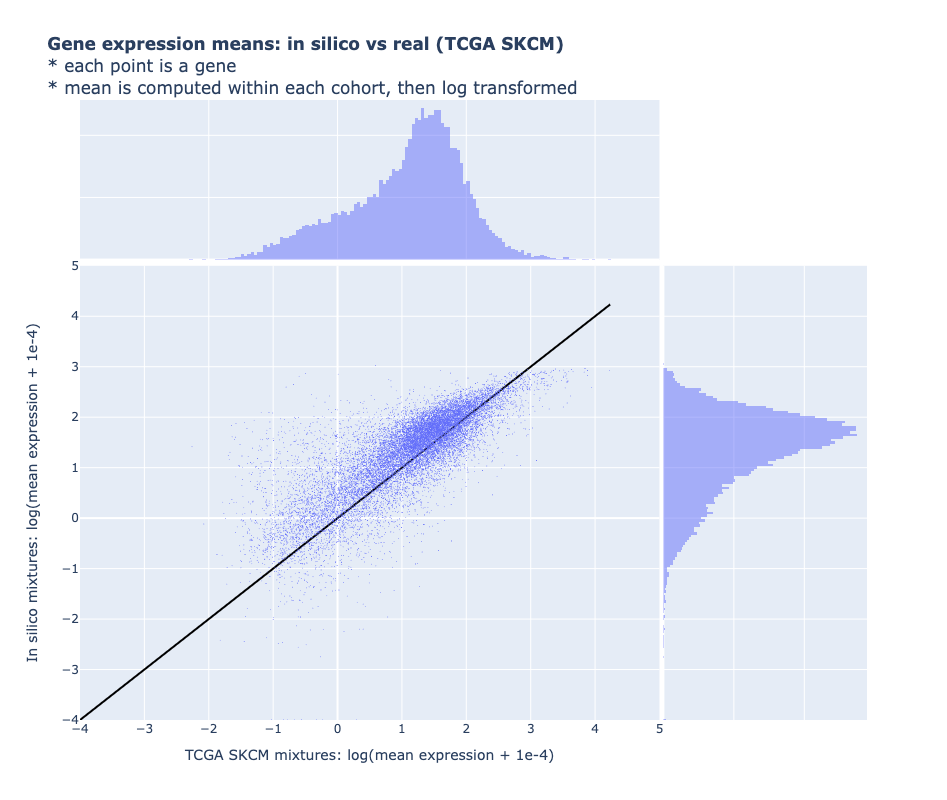

In [56]:
df = pd.DataFrame(
    {
        label_real: np.log10(mixtures_tcga_skcm.mean(axis=1) + 1e-4),
        f"{label_real} sparsity": (mixtures_tcga_skcm == 0).mean(axis=1),
        label_pseudo: np.log10(mixtures_in_silico.mean(axis=1) + 1e-4),
        f"{label_pseudo} sparsity": (mixtures_in_silico == 0).mean(axis=1),
    },
)

title = (
    "<b>Gene expression means: in silico vs real (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* mean is computed within each cohort, then log transformed"
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
    hover_data=df.columns,
)
fig.add_trace(
    go.Scatter(
        x=[df.values.min(), df.values.max()],
        y=[df.values.min(), df.values.max()],
        marker_color="black",
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM mixtures: log(mean expression + 1e-4)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=[-4, 5],
)  # , range=[0, 10])  # , type="log")
fig.update_yaxes(
    title="In silico mixtures: log(mean expression + 1e-4)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=[-4, 5],
)  # , range=[0, 10])  # , type="log")
fig.show(height=800)

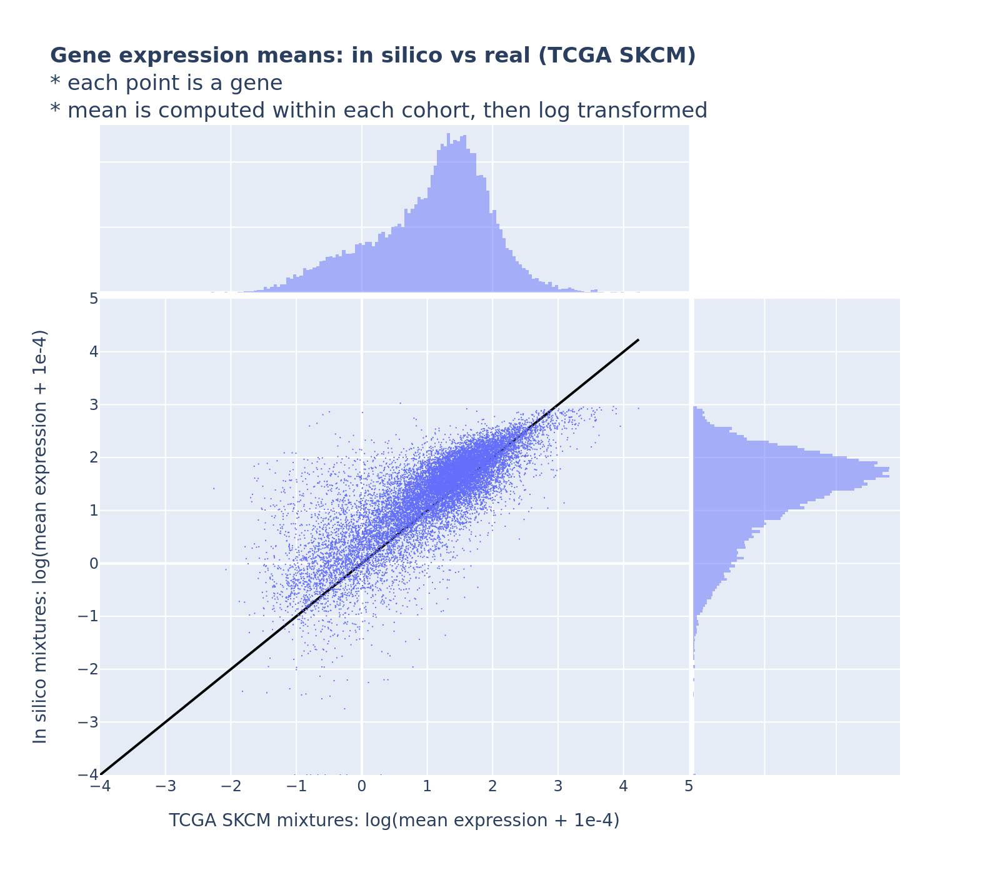

In [57]:
fig.show(width=800, height=700, scale=2, renderer="png")

### K-S comparison

In [58]:
import scipy.stats

#### mean(gene expression)

In [59]:
scipy.stats.kstest(mixtures_tcga_skcm.mean(axis=1), mixtures_in_silico.mean(axis=1))

KstestResult(statistic=0.13505851128000962, pvalue=2.5046813458258302e-132)

#### mean(log(gene expression + 1))

In [60]:
scipy.stats.kstest(
    np.log10(mixtures_tcga_skcm + 1e-4).mean(axis=1),
    np.log10(mixtures_in_silico + 1e-4).mean(axis=1),
)

KstestResult(statistic=0.14633852093135483, pvalue=2.1791302032480756e-155)

#### sanity test (testing random splits of TCGA SKCM)

In [61]:
columns = list(mixtures_tcga_skcm.columns)
np.random.default_rng().shuffle(columns)
group_a, group_b = columns[0::2], columns[1::2]

# print(columns[:6])
# print(group_a[:3])
# print(group_b[:3])

scipy.stats.kstest(
    mixtures_tcga_skcm[group_a].mean(axis=1), mixtures_tcga_skcm[group_b].mean(axis=1)
)

KstestResult(statistic=0.007600434310532034, pvalue=0.7215403536072635)

#### plot of CDFs

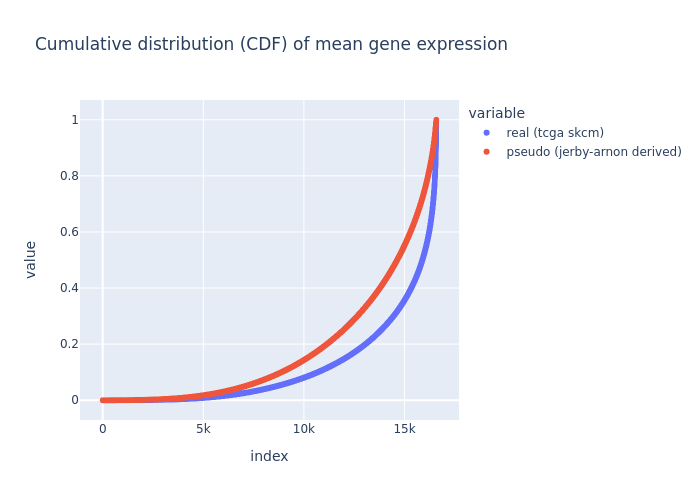

In [62]:
df = pd.concat(
    {
        label_real: (
            mixtures_tcga_skcm.mean(axis=1).sort_values().cumsum() * 1e-6
        ).reset_index(drop=True),
        label_pseudo: (
            mixtures_in_silico.mean(axis=1).sort_values().cumsum() * 1e-6
        ).reset_index(drop=True),
    },
    axis=1,
)

px.scatter(
    df,
    title=("Cumulative distribution (CDF) of mean gene expression"),
)

In [63]:
max(abs(df.iloc[:, 0] - df.iloc[:, 1]))

0.22193787500639817

### PCA

In [64]:
df = pd.concat([mixtures_tcga_skcm, mixtures_in_silico], axis=1).T
df.shape

(735, 16578)

In [65]:
sample_origin = df.index.map(
    lambda x: "in silico" if x[:9] == "in_silico" else "TCGA SKCM"
)

In [66]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(df)
df.values[:] = scaler.transform(df)

In [67]:
print(df.iloc[:, :5].mean())
print(df.iloc[:, :5].std())

gene_symbol
A1BG     -3.510419e-16
A1CF      1.842819e-17
A2M      -2.666046e-17
A2ML1    -3.601050e-16
A4GALT   -1.099272e-16
dtype: float64
gene_symbol
A1BG      1.000681
A1CF      1.000681
A2M       1.000681
A2ML1     1.000681
A4GALT    1.000681
dtype: float64


In [68]:
features = list(df.columns)

In [69]:
from sklearn.decomposition import PCA

In [70]:
pca = PCA(n_components=20)

In [71]:
pca.fit(df)

PCA(n_components=20)

In [72]:
pca.components_.shape

(20, 16578)

In [73]:
pca.explained_variance_

array([2432.2376287 ,  576.69260109,  403.33169967,  364.95355844,
        340.5553008 ,  280.83332344,  241.54797747,  213.44991355,
        200.66580706,  189.98511639,  172.67280139,  169.42038261,
        155.83585996,  142.23739187,  134.44234771,  127.52048471,
        120.22195178,  117.9548505 ,  112.73871928,  107.41016387])

In [74]:
pca.explained_variance_ratio_

array([0.14651517, 0.03473929, 0.02429623, 0.02198438, 0.02051466,
       0.01691707, 0.01455057, 0.01285797, 0.01208788, 0.01144448,
       0.01040161, 0.01020569, 0.00938737, 0.00856822, 0.00809865,
       0.00768169, 0.00724203, 0.00710546, 0.00679125, 0.00647026])

In [75]:
# labels = {str(i): f"PC {i+1}<br>({var:.1f}%)" for i, var in enumerate(pca.explained_variance_ratio_ * 100)}
labels = {
    str(i): f"PC_{i+1:02d}<br>({var:04.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

In [76]:
sample_pc_coefficients = pd.DataFrame(pca.transform(df), index=df.index)

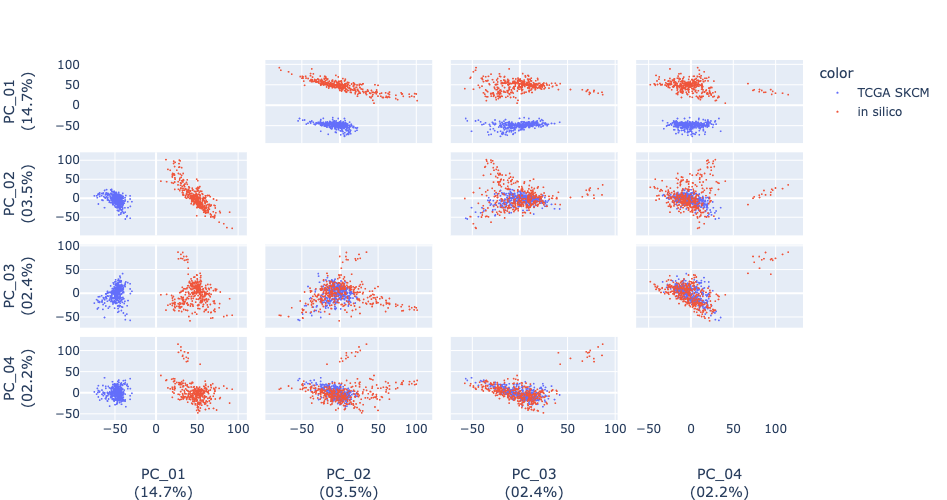

In [77]:
fig = px.scatter_matrix(
    sample_pc_coefficients,
    labels=labels,
    dimensions=range(4),
    color=sample_origin,
    hover_name=df.index,
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))

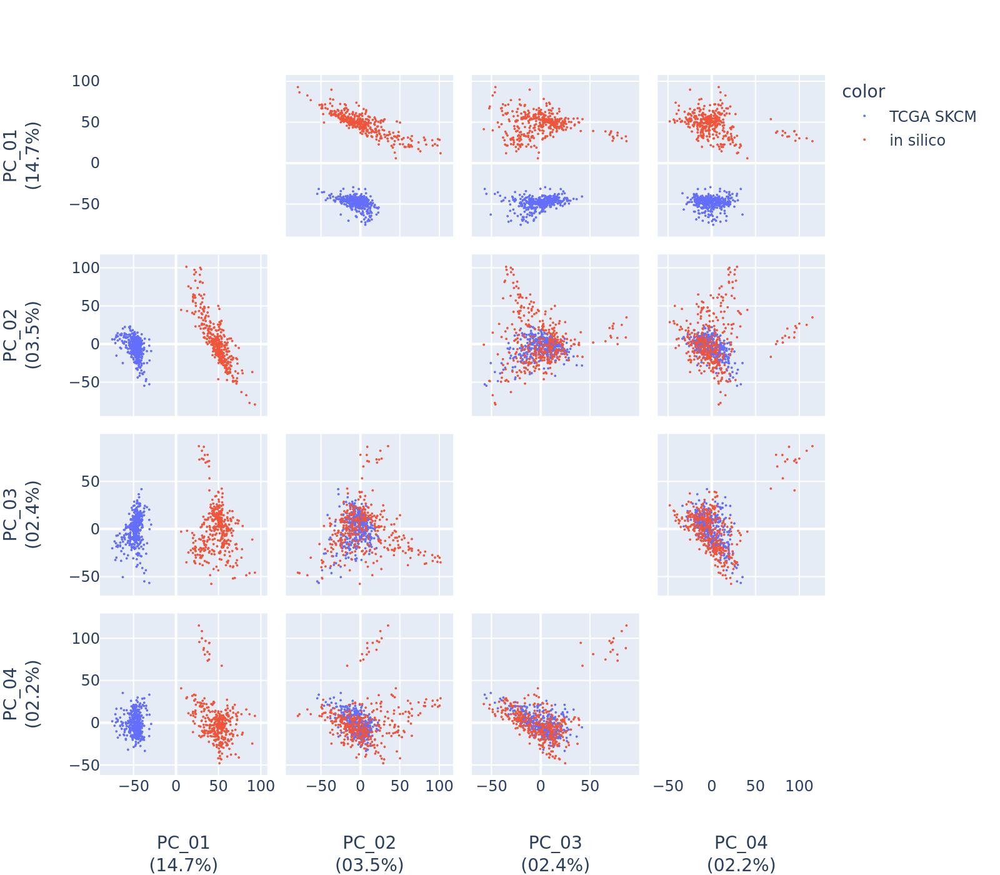

In [78]:
fig.show(width=800, height=700, scale=2, renderer="png")

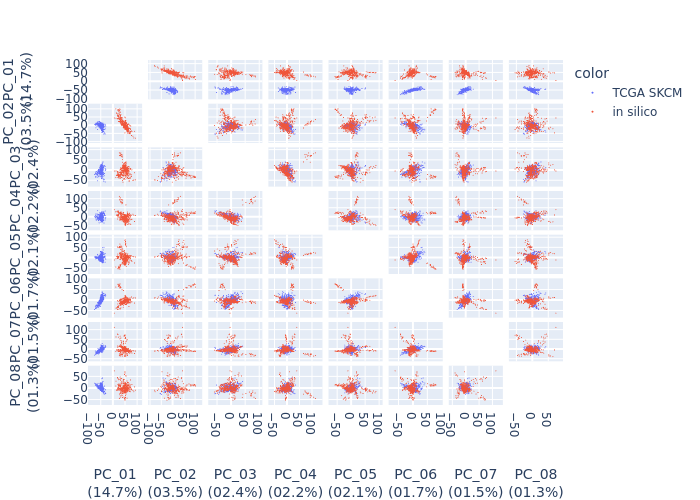

In [79]:
fig = px.scatter_matrix(
    sample_pc_coefficients,
    labels=labels,
    dimensions=range(8),
    color=sample_origin,
    hover_name=df.index,
)
fig.update_traces(diagonal_visible=False, marker=dict(size=1))
fig.show()

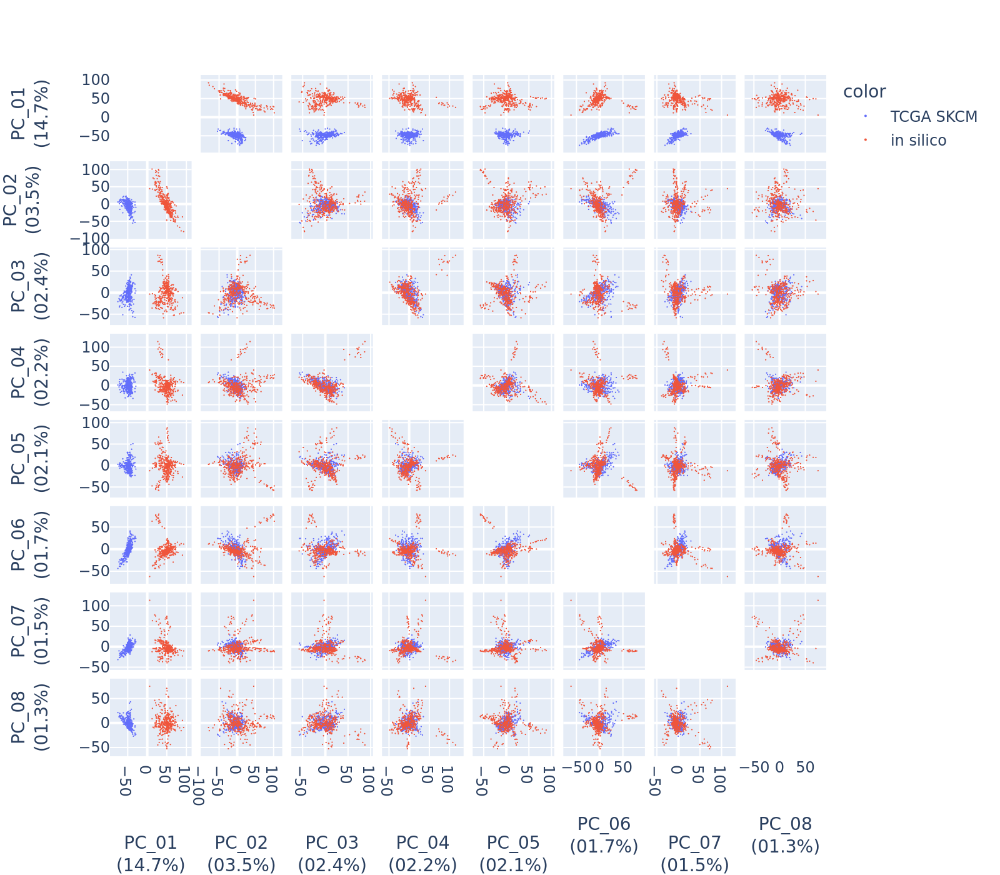

In [80]:
fig.show(width=800, height=700, scale=2, renderer="png")

In [81]:
def make_fig():
    pca = PCA(n_components=3)
    components = pca.fit_transform(df)
    total_var = pca.explained_variance_ratio_.sum() * 100

    fig = px.scatter_3d(
        components,
        x=0,
        y=1,
        z=2,
        color=sample_origin,
        title=f"Total Explained Variance: {total_var:.2f}%",
        labels={"0": "PC 1", "1": "PC 2", "2": "PC 3"},
        hover_name=df.index,
    )
    fig.update_traces(marker=dict(size=1))
    fig.update_layout(showlegend=False)
    return fig


fig = make_fig()

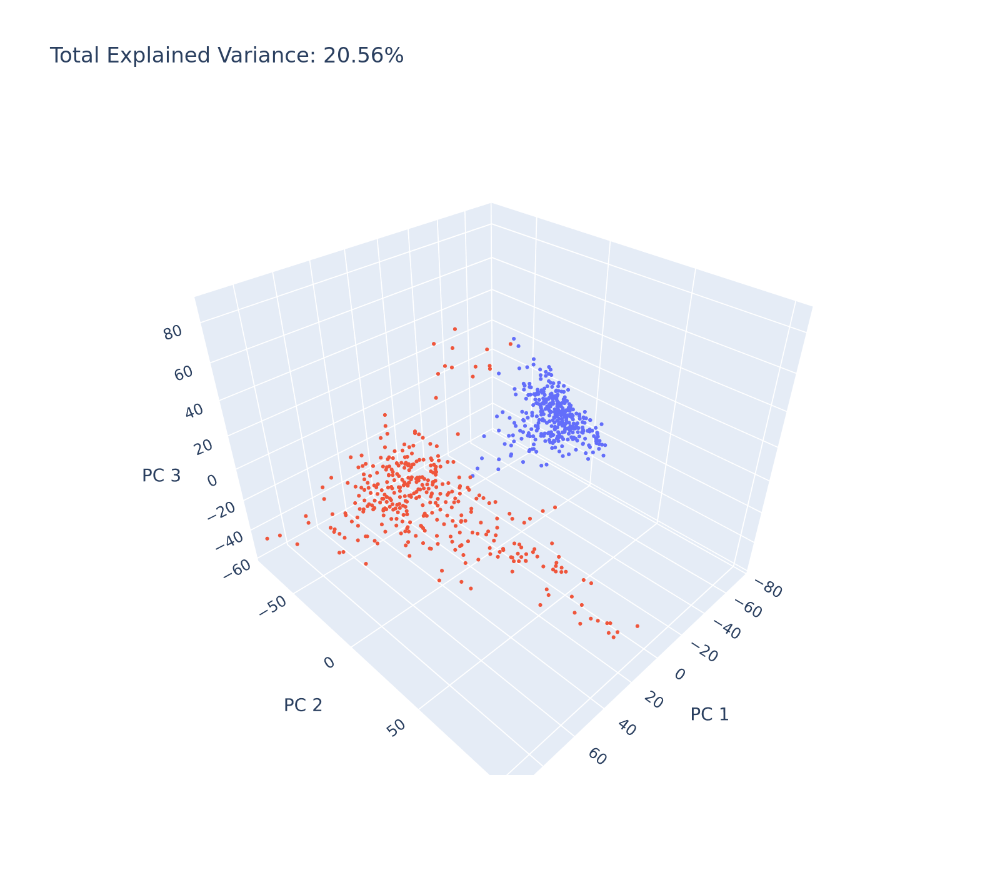

In [82]:
fig.show(width=800, height=700, scale=2, renderer="png")

#### investigation of first PC

In [83]:
pca.components_.shape

(20, 16578)

why are pseudobulks different?
* is it a cell type thing?
  * a particular cell type?
    * plot: add PC coeffs of each pseudobulk's cell type GEP to biplot

* is it due to certain genes or gene types?
  * sparse genes?
    * plot: loadings of each gene, for each PC, sized by its sparsity rate 
  * low expressed genes?
    * plot: loadings of each gene, for each PC, sized by its mean(expression)
  * high variance genes?
    * plot: loadings of each gene, for each PC, sized by its stddev(expression)

what causes some pseudobulks to be 

In [84]:
_ = pd.concat(cell_type_geps, axis=1)
_ = _.loc[df.columns]
_ = _.T
_ = _.rename_axis(index=[helpers.columns.SAMPLE_ID, helpers.columns.CELL_TYPE])
pseudobulk_cell_type_geps = _

In [85]:
# RESUME

In [86]:
pseudobulk_cell_type_geps.head(3)

gene_symbol                                                   A1BG      A1CF  \
sample_id                                   cell_type                          
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            17.311467  0.359362   
                                            CAF           0.000000  3.974756   
                                            Endothelial  42.923600  0.715698   

gene_symbol                                                     A2M  \
sample_id                                   cell_type                 
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B              0.000000   
                                            CAF          275.289443   
                                            Endothelial  650.702929   

gene_symbol                                                  A2ML1  \
sample_id                                   cell_type                
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B             6.373360   
                                            CAF           0.000000   
                                            Endothelial  13.632723   

gene_symbol                                                  A4GALT  A4GNT  \
sample_id                                   cell_type                        
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B              0.000000    0.0   
                                            CAF           20.501034    0.0   
                                            Endothelial  219.874158    0.0   

gene_symbol                                                   AAAS       AACS  \
sample_id                                   cell_type                           
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B             0.000000   0.000000   
                                            CAF          18.054325  31.004673   
                                            Endothelial  79.692766   0.000000   

gene_symbol                                                  AADAC  AADAT  \
sample_id                                   cell_type                       
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B             0.000000    0.0   
                                            CAF          73.648925    0.0   
                                            Endothelial   0.000000    0.0   

gene_symbol                                              ...      ZWILCH  \
sample_id                                   cell_type    ...               
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            ...    0.000000   
                                            CAF          ...  115.332038   
                                            Endothelial  ...   23.640772   

gene_symbol                                                  ZWINT  ZXDA  \
sample_id                                   cell_type                      
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B              0.00000   0.0   
                                            CAF          126.63501   0.0   
                                            Endothelial    0.00000   0.0   

gene_symbol                                                   ZXDB       ZXDC  \
sample_id                                   cell_type                           
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B             0.000000  75.079518   
                                            CAF           0.000000  24.496789   
                                            Endothelial  51.687564  74.892059   

gene_symbol                                                 ZYG11A     ZYG11B  \
sample_id                                   cell_type                           
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            67.148761  82.365941   
                                            CAF          43.168425  28.849841   
                                            Endothelial  85.167921  79.402600   

gene_symbol                                                     ZYX  \
sample_id                                   cell_type           

In [87]:
pseudobulk_cell_type_geps.head(3).sum(axis=1)

sample_id                                    cell_type  
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07  B              897788.870247
                                             CAF            934134.223622
                                             Endothelial    914428.997782
dtype: float64

In [88]:
pseudobulk_cell_type_geps_pc_coefficients = pd.DataFrame(
    pca.transform(pseudobulk_cell_type_geps), index=pseudobulk_cell_type_geps.index
)

In [89]:
pseudobulk_cell_type_geps_pc_coefficients.shape

(4257, 20)

In [90]:
sample_pc_coefficients.shape

(735, 20)

In [91]:
pseudobulk_cell_type_geps_pc_coefficients.head(3)

0   \
sample_id                                   cell_type                  
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            5056.958693   
                                            CAF          4025.935633   
                                            Endothelial  4464.213665   

                                                                  1   \
sample_id                                   cell_type                  
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            -615.434878   
                                            CAF          1315.538979   
                                            Endothelial  -256.701904   

                                                                  2   \
sample_id                                   cell_type                  
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B           -2377.354182   
                                            CAF           886.049541   
                                            Endothelial    29.105003   

                                                                 3   \
sample_id                                   cell_type                 
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            254.840897   
                                            CAF         -123.878448   
                                            Endothelial   30.723054   

                                                                 4   \
sample_id                                   cell_type                 
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            583.404232   
                                            CAF          819.394391   
                                            Endothelial  -52.485734   

                                                                 5   \
sample_id                                   cell_type                 
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            723.758139   
                                            CAF          618.063055   
                                            Endothelial  485.407812   

                                                                 6   \
sample_id                                   cell_type                 
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            833.531042   
                                            CAF          898.365493   
                                            Endothelial  639.905849   

                                                                  7   \
sample_id                                   cell_type                  
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B           -1489.919760   
                                            CAF           961.563456   
                                            Endothelial   124.041322   

                                                                 8   \
sample_id                                   cell_type                 
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            -97.457608   
                                            CAF          764.954671   
                                            Endothelial  393.034229   

                                                                  9   \
sample_id                                   cell_type                  
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B           -1416.971715   
                                            CAF          -374.778250   
                                            Endothelial  -465.154643   

                                                                  10  \
sample_id                                   cell_type                  
in_silico_like_TCGA-3N-A9WB-06A-11R-A38C-07 B            1269.632261   
                                            CAF            -3.257924   
                                            Endothelial   513.376618   

                                                                  11  \
sample_id                                   cell

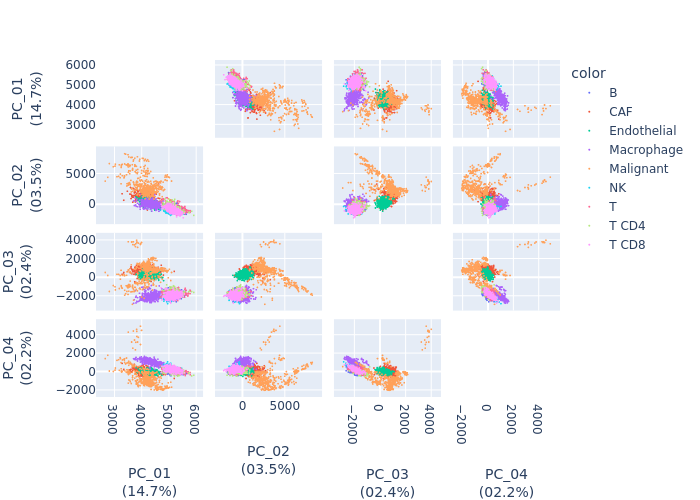

In [92]:
fig = px.scatter_matrix(
    pseudobulk_cell_type_geps_pc_coefficients,
    labels=labels,
    dimensions=range(4),
    color=pseudobulk_cell_type_geps_pc_coefficients.index.get_level_values(1),
    hover_name=pseudobulk_cell_type_geps_pc_coefficients.index.get_level_values(0),
)
fig.update_traces(diagonal_visible=False, marker=dict(size=2))

In [93]:
sample_pc_coefficients["cell_type"] = "bulk"

### expression distribution of low-expression genes

In [94]:
print("percent of genes that are expressed in fewer than half of samples")

gene_is_expressed = mixtures_tcga_skcm > 0
how_often_each_gene_is_expressed = gene_is_expressed.mean(axis=1)
(how_often_each_gene_is_expressed < 0.5).mean()

percent of genes that are expressed in fewer than half of samples


0.0027144408251900108

In [95]:
print("percent of genes that are expressed in fewer than half of samples")

gene_is_expressed = mixtures_in_silico > 0
how_often_each_gene_is_expressed = gene_is_expressed.mean(axis=1)
(how_often_each_gene_is_expressed < 0.5).mean()

percent of genes that are expressed in fewer than half of samples


0.18307395343225963

### appendix - other comparisons

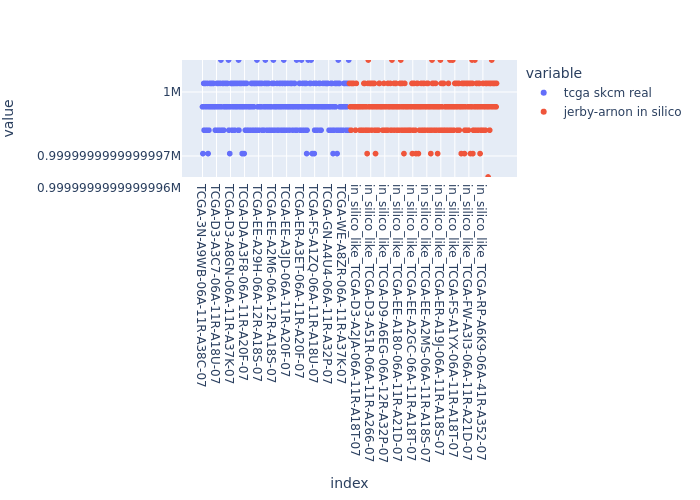

In [96]:
df = pd.DataFrame(
    {
        "tcga skcm real": mixtures_tcga_skcm.sum(),
        "jerby-arnon in silico": mixtures_in_silico.sum(),
    }
)

px.scatter(df)

In [97]:
mixtures_tcga_skcm.mean(axis=1).describe()

count    16578.000000
mean        60.320907
std        265.966102
min          0.005412
25%          3.486561
50%         17.105212
75%         47.742632
max      17102.671917
dtype: float64

In [98]:
mixtures_in_silico.mean(axis=1).describe()

count    16578.000000
mean        60.320907
std         92.988961
min          0.000000
25%          7.213299
50%         29.541698
75%         74.071396
max       1070.987219
dtype: float64

## comparison: stddev(gene expression)

### correlations

#### stddev(gene expression)

In [99]:
pd.concat(
    {
        label_real: mixtures_tcga_skcm.std(axis=1),
        label_pseudo: mixtures_in_silico.std(axis=1),
    },
    axis=1,
).corr()

,real (tcga skcm),pseudo (jerby-arnon derived)
real (tcga skcm),1.000000,0.387913
pseudo (jerby-arnon derived),0.387913,1.000000


#### stddev(log(gene expression + 1))

In [100]:
pd.concat(
    {
        label_real: np.log(mixtures_tcga_skcm + 1).std(axis=1),
        label_pseudo: np.log(mixtures_in_silico + 1).std(axis=1),
    },
    axis=1,
).corr()

,real (tcga skcm),pseudo (jerby-arnon derived)
real (tcga skcm),1.000000,0.420123
pseudo (jerby-arnon derived),0.420123,1.000000


### scatter plot

#### log scale

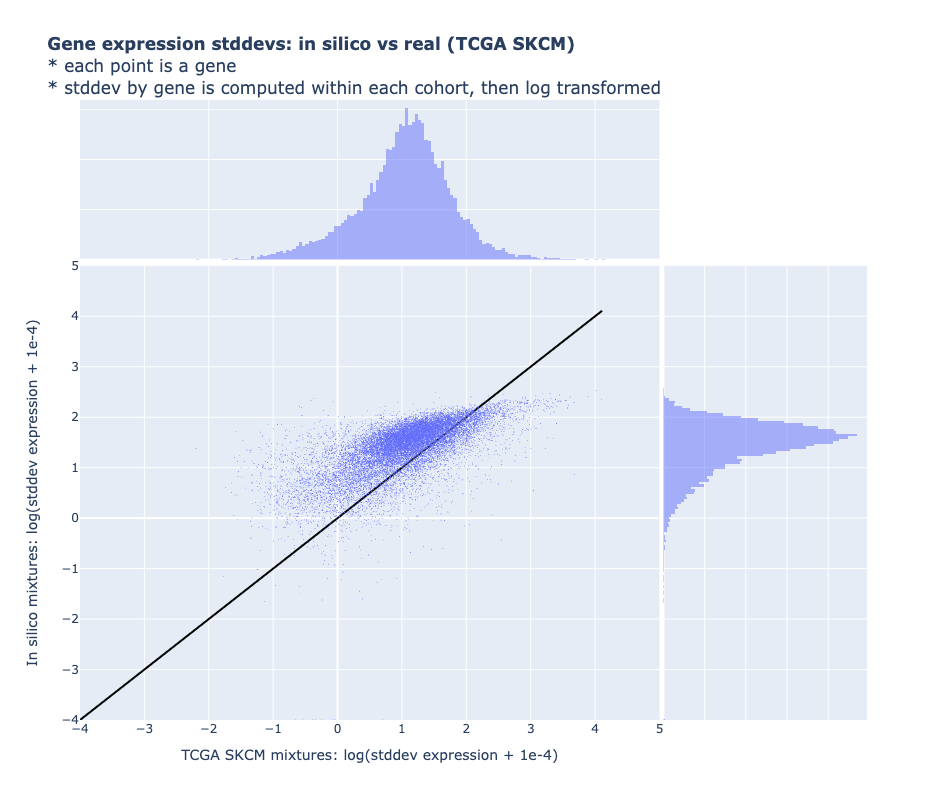

In [101]:
df = pd.concat(
    {
        label_real: np.log10(mixtures_tcga_skcm.std(axis=1) + 1e-4),
        label_pseudo: np.log10(mixtures_in_silico.std(axis=1) + 1e-4),
    },
    axis=1,
)

title = (
    "<b>Gene expression stddevs: in silico vs real (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* stddev by gene is computed within each cohort, then log transformed"
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="histogram",
    marginal_y="histogram",
    hover_name=df.index,
)
fig.add_trace(
    go.Scatter(
        x=[df.values.min(), df.values.max()],
        y=[df.values.min(), df.values.max()],
        marker_color="black",
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=1), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM mixtures: log(stddev expression + 1e-4)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=[-4, 5],
)  # , range=[0, 10])  # , type="log")
fig.update_yaxes(
    title="In silico mixtures: log(stddev expression + 1e-4)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
    range=[-4, 5],
)  # , range=[0, 10])  # , type="log")
fig.show(height=800)

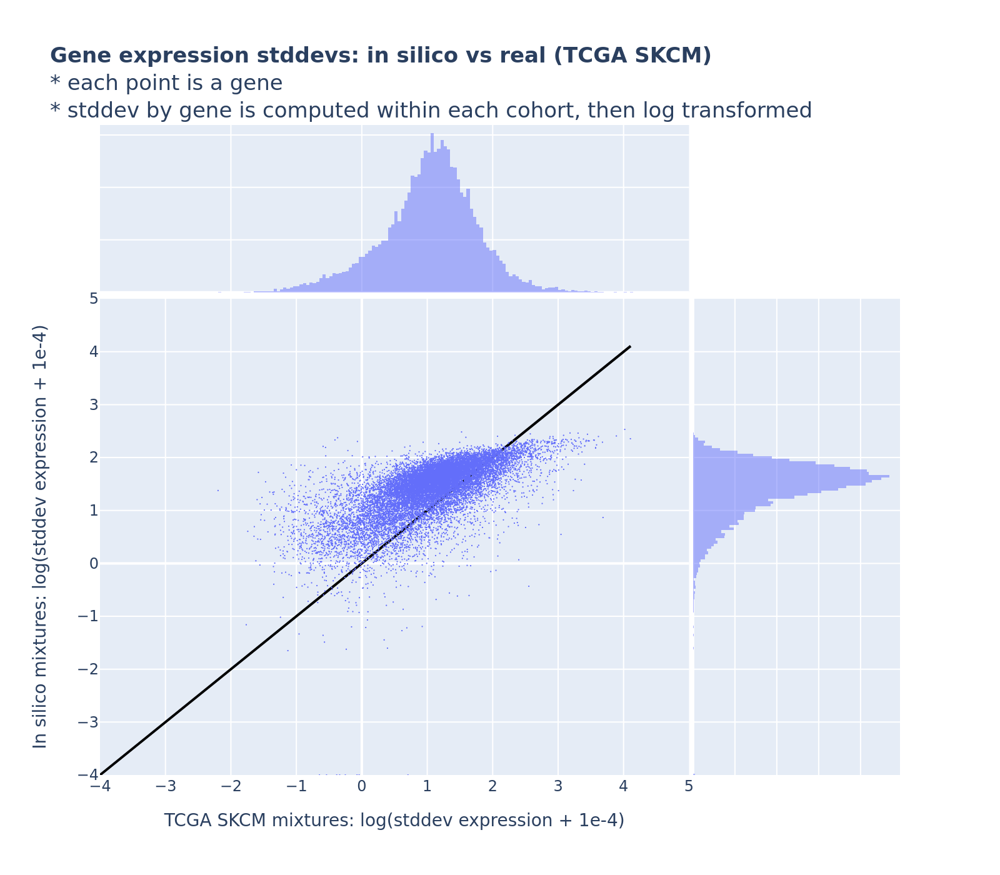

In [102]:
fig.show(width=800, height=700, scale=2, renderer="png")

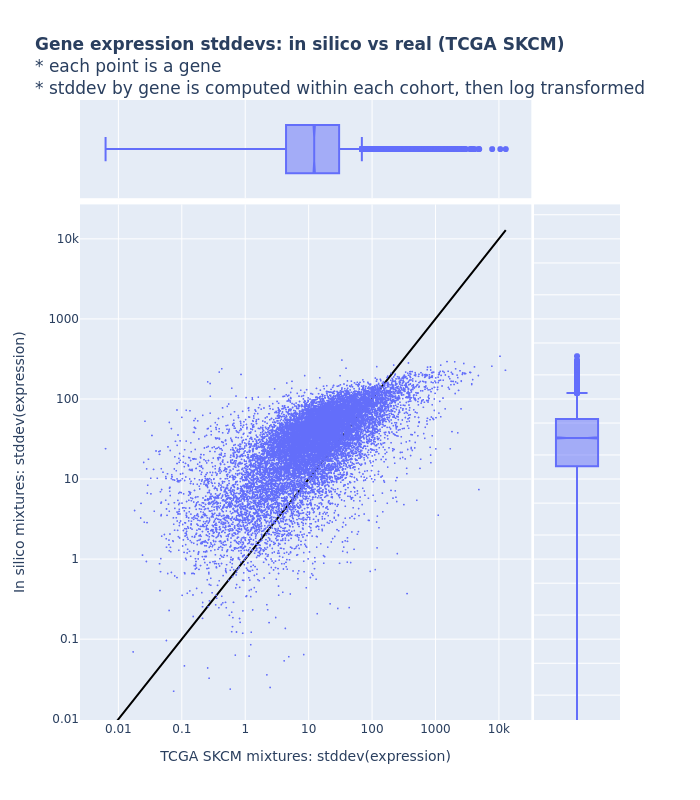

In [103]:
df = pd.concat(
    {
        label_real: mixtures_tcga_skcm.std(axis=1),
        label_pseudo: mixtures_in_silico.std(axis=1),
    },
    axis=1,
)

title = (
    "<b>Gene expression stddevs: in silico vs real (TCGA SKCM)</b>"
    "<br>* each point is a gene"
    "<br>* stddev by gene is computed within each cohort, then log transformed"
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title=title,
    marginal_x="box",
    marginal_y="box",
    hover_name=df.index,
    log_x=True,
    log_y=True,
)
fig.add_trace(
    go.Scatter(
        x=[0, df.values.max()],
        y=[0, df.values.max()],
        marker_color="black",
        showlegend=False,
        mode="lines",
    ),
    row=1,
    col=1,
)
fig.update_traces(marker=dict(size=2), row=1, col=1)
fig.update_xaxes(
    title="TCGA SKCM mixtures: stddev(expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
)  # , range=[0, 10])  # , type="log")
fig.update_yaxes(
    title="In silico mixtures: stddev(expression)",
    rangemode="tozero",
    dtick=1,
    row=1,
    col=1,
)  # , range=[0, 10])  # , type="log")
fig.show(height=800)

## plot summary stats

by gene, in silico vs real

In [104]:
def prep_for_plots(mixtures):
    mean_expression_per_gene = mixtures.mean(axis=1)
    return np.log(mean_expression_per_gene + 1)

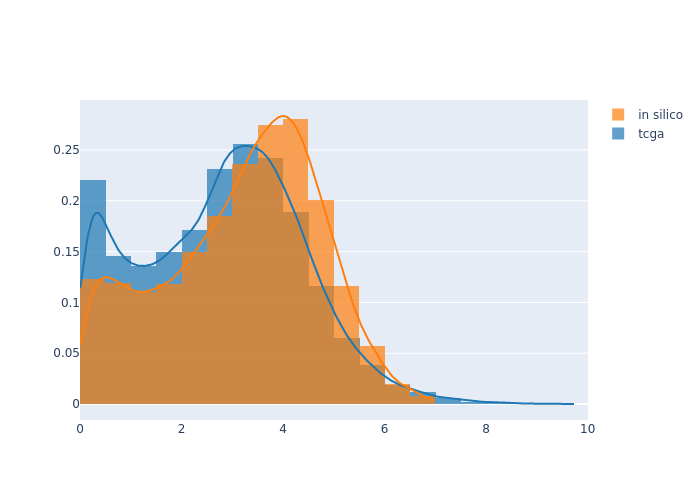

In [105]:
series = [
    prep_for_plots(mixtures_tcga_skcm),
    prep_for_plots(mixtures_in_silico),
]

ff.create_distplot(
    series, ["tcga", "in silico"], show_rug=False, show_hist=True, bin_size=0.5
)

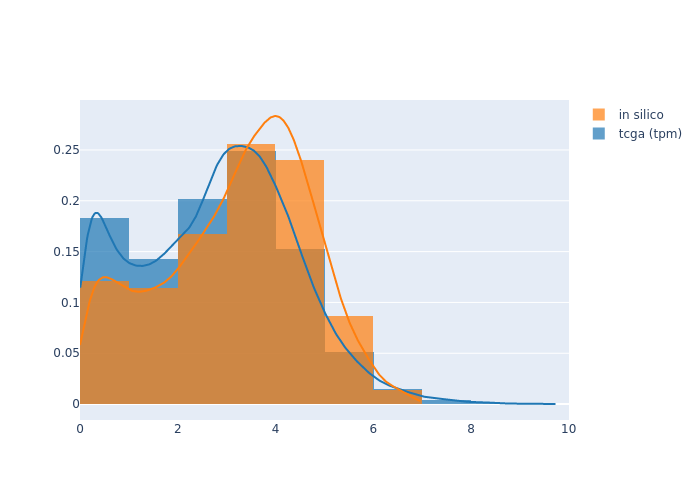

In [106]:
mixtures_tcga_skcm_per_million = helpers.generating_pseudobulks.normalize_expression(
    mixtures_tcga_skcm, 1_000_000
)

series = [
    prep_for_plots(mixtures_tcga_skcm_per_million),
    prep_for_plots(mixtures_in_silico),
]

ff.create_distplot(series, ["tcga (tpm)", "in silico"], show_rug=False, show_hist=True)

In [107]:
def compute_means(mixtures):
    base_means = mixtures_tcga_skcm.mean(axis=1)
    return np.log(base_means + 1)


mean_expressions = pd.DataFrame(
    {
        "TCGA SKCM": compute_means(mixtures_tcga_skcm),
        "in silico": compute_means(mixtures_in_silico),
    }
)

In [108]:
compute_means(mixtures_tcga_skcm)

gene_symbol
A1BG      0.684146
A1CF      0.020891
A2M       7.237299
A2ML1     0.942685
A4GALT    2.557281
            ...   
ZYG11A    0.289361
ZYG11B    3.177710
ZYX       5.771422
ZZEF1     3.028861
ZZZ3      3.295690
Length: 16578, dtype: float64

In [109]:
compute_means(mixtures_in_silico)

gene_symbol
A1BG      0.684146
A1CF      0.020891
A2M       7.237299
A2ML1     0.942685
A4GALT    2.557281
            ...   
ZYG11A    0.289361
ZYG11B    3.177710
ZYX       5.771422
ZZEF1     3.028861
ZZZ3      3.295690
Length: 16578, dtype: float64

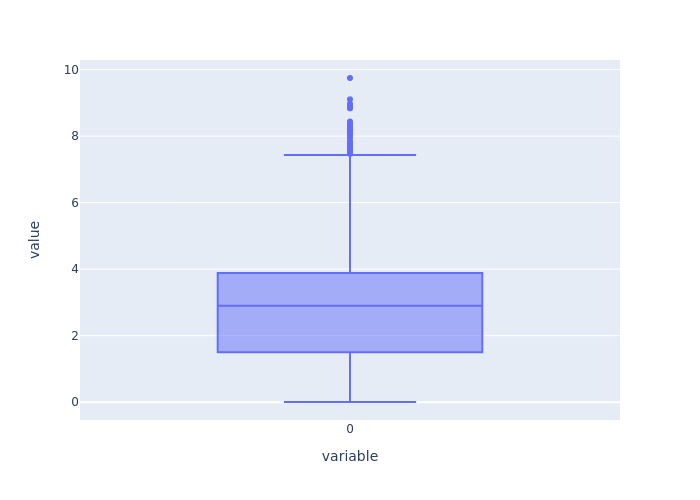

In [110]:
px.box(compute_means(mixtures_tcga_skcm))

In [111]:
assert False, "stop executing cells"

AssertionError: stop executing cells

In [ ]:
# px.box([compute_means(mixtures_tcga_skcm), compute_means(mixtures_in_silico)])

# output 1 junkyard

## comparison: total counts

In [ ]:
df = pd.DataFrame(
    {
        label_real: mixtures_tcga_skcm.sum(),
        label_pseudo: mixtures_in_silico.sum(),
    }
)

fig = px.scatter(
    df,
    x=label_real,
    y=label_pseudo,
    title="Scatter plot of real vs pseudobulk mixtures: sum of counts per sample",
)
fig.update_xaxes(rangemode="tozero")
fig.update_yaxes(rangemode="tozero")

## scatter

#### linear scale

In [ ]:
df = pd.concat(
    {
        label_real: mixtures_tcga_skcm.mean(axis=1),
        label_pseudo: mixtures_in_silico.mean(axis=1),
    },
    axis=1,
)

fig = px.scatter(
    df.sample(5000),
    x=label_real,
    y=label_pseudo,
    title="Scatter plot of real vs pseudobulk mixtures: mean expression per gene",
    # trendline="ols",
    # marginal_x="histogram",
    # marginal_y="histogram",
)
fig.update_xaxes(rangemode="tozero", type="log")
fig.update_yaxes(rangemode="tozero", type="log")
fig.show(width=800, height=800, scale=2)

# output 2: estimated cell type fractions

## run cibersortx fractions on in silico mixtures

In [ ]:
import tempfile

In [ ]:
temp_dir = tempfile.TemporaryDirectory()

print(temp_dir)

In [ ]:
from helpers.running_csx import DockerJob, Experiment, InputFile

In [ ]:
experiments_root = "gs://liulab/csx_experiments/tcga_skcm_fractions"
experiment = Experiment(experiments_root, "test1")

In [ ]:
!tree -h {experiment.local_path}/..

In [ ]:
input_file_args = {
    "mixture": InputFile(
        "mixturestirosh.txt",
        "gs://liulab/csx_example_files/Single_Cell_RNA-Seq_Melanoma_SuppFig_3b-d/mixture_melanoma_Tirosh_SuppFig_3b-d.txt",
    ),
    "sigmatrix": InputFile(),
}

In [ ]:

job = DockerJob(temp_dir, input_file_args, other_args)
    for copy_command in job.make_copy_commands():
        !{copy_command}
    !tree -h {job.path}
    docker_command = job.make_docker_command()
    print(docker_command)
    !{docker_command}
    !tree -h {job.path}
    !gsutil -m rsync -r -d {job.path} {experiment.gcs_uri}


### prep input files

In [ ]:
from helpers.csx_docker import save_valid_mixture_file, save_valid_fractions_file

with open("mixture.txt", "w") as f:
    save_valid_mixture_file(mixtures, f)
with open("fractions.txt", "w") as f:
    save_valid_fractions_file(fractions, f)

### run cibersortx

In [ ]:
run_csx(path="...")

### load and process outputs

## evaluate results

# output 3: estimated gene expression by cell type

## run cibersortx expression imputation on in silico mixtures

## volcano plot outputs

In [ ]:
# for each cell type, scatter plot (effect_size, p_value) for each gene